In [1]:
# importing libraries

import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from matplotlib import rcParams
%matplotlib inline
import seaborn as sns

In [2]:
# read data 

data = pd.read_csv('breast_cancer.csv')
print(data.shape)
data.head()

(569, 33)


,id,diagnosis,radius_mean,texture_mean,perimeter_mean,area_mean,smoothness_mean,compactness_mean,concavity_mean,concave points_mean,...,texture_worst,perimeter_worst,area_worst,smoothness_worst,compactness_worst,concavity_worst,concave points_worst,symmetry_worst,fractal_dimension_worst,Unnamed: 32
0,842302,M,17.99,10.38,122.80,1001.0,0.11840,0.27760,0.3001,0.14710,...,17.33,184.60,2019.0,0.1622,0.6656,0.7119,0.2654,0.4601,0.11890,NaN
1,842517,M,20.57,17.77,132.90,1326.0,0.08474,0.07864,0.0869,0.07017,...,23.41,158.80,1956.0,0.1238,0.1866,0.2416,0.1860,0.2750,0.08902,NaN
2,84300903,M,19.69,21.25,130.00,1203.0,0.10960,0.15990,0.1974,0.12790,...,25.53,152.50,1709.0,0.1444,0.4245,0.4504,0.2430,0.3613,0.08758,NaN
3,84348301,M,11.42,20.38,77.58,386.1,0.14250,0.28390,0.2414,0.10520,...,26.50,98.87,567.7,0.2098,0.8663,0.6869,0.2575,0.6638,0.17300,NaN
4,84358402,M,20.29,14.34,135.10,1297.0,0.10030,0.13280,0.1980,0.10430,...,16.67,152.20,1575.0,0.1374,0.2050,0.4000,0.1625,0.2364,0.07678,NaN


In [3]:
data.columns

Index(['id', 'diagnosis', 'radius_mean', 'texture_mean', 'perimeter_mean',
       'area_mean', 'smoothness_mean', 'compactness_mean', 'concavity_mean',
       'concave points_mean', 'symmetry_mean', 'fractal_dimension_mean',
       'radius_se', 'texture_se', 'perimeter_se', 'area_se', 'smoothness_se',
       'compactness_se', 'concavity_se', 'concave points_se', 'symmetry_se',
       'fractal_dimension_se', 'radius_worst', 'texture_worst',
       'perimeter_worst', 'area_worst', 'smoothness_worst',
       'compactness_worst', 'concavity_worst', 'concave points_worst',
       'symmetry_worst', 'fractal_dimension_worst', 'Unnamed: 32'],
      dtype='object')

In [4]:
len(data.columns)

33

In [5]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 569 entries, 0 to 568
Data columns (total 33 columns):
 #   Column                   Non-Null Count  Dtype  
---  ------                   --------------  -----  
 0   id                       569 non-null    int64  
 1   diagnosis                569 non-null    object 
 2   radius_mean              569 non-null    float64
 3   texture_mean             569 non-null    float64
 4   perimeter_mean           569 non-null    float64
 5   area_mean                569 non-null    float64
 6   smoothness_mean          569 non-null    float64
 7   compactness_mean         569 non-null    float64
 8   concavity_mean           569 non-null    float64
 9   concave points_mean      569 non-null    float64
 10  symmetry_mean            569 non-null    float64
 11  fractal_dimension_mean   569 non-null    float64
 12  radius_se                569 non-null    float64
 13  texture_se               569 non-null    float64
 14  perimeter_se             5

In [6]:
# except diagnosis all the columns have numeric form data

In [7]:
data.diagnosis.value_counts()

B    357
M    212
Name: diagnosis, dtype: int64

# Business problem : find person have B or M type diagnosis

In [8]:
data.isnull().sum()

id                           0
diagnosis                    0
radius_mean                  0
texture_mean                 0
perimeter_mean               0
area_mean                    0
smoothness_mean              0
compactness_mean             0
concavity_mean               0
concave points_mean          0
symmetry_mean                0
fractal_dimension_mean       0
radius_se                    0
texture_se                   0
perimeter_se                 0
area_se                      0
smoothness_se                0
compactness_se               0
concavity_se                 0
concave points_se            0
symmetry_se                  0
fractal_dimension_se         0
radius_worst                 0
texture_worst                0
perimeter_worst              0
area_worst                   0
smoothness_worst             0
compactness_worst            0
concavity_worst              0
concave points_worst         0
symmetry_worst               0
fractal_dimension_worst      0
Unnamed:

In [9]:
# only 'Unnamed: 32' column have null values in 569 row out of 569 
# so drop this column

In [10]:
data=data.rename(columns={'Unnamed: 32' : 'Nothing'})

data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 569 entries, 0 to 568
Data columns (total 33 columns):
 #   Column                   Non-Null Count  Dtype  
---  ------                   --------------  -----  
 0   id                       569 non-null    int64  
 1   diagnosis                569 non-null    object 
 2   radius_mean              569 non-null    float64
 3   texture_mean             569 non-null    float64
 4   perimeter_mean           569 non-null    float64
 5   area_mean                569 non-null    float64
 6   smoothness_mean          569 non-null    float64
 7   compactness_mean         569 non-null    float64
 8   concavity_mean           569 non-null    float64
 9   concave points_mean      569 non-null    float64
 10  symmetry_mean            569 non-null    float64
 11  fractal_dimension_mean   569 non-null    float64
 12  radius_se                569 non-null    float64
 13  texture_se               569 non-null    float64
 14  perimeter_se             5

In [11]:
data.shape

(569, 33)

In [12]:
# from the above checks the is a column which has totally null values 
# so lets delete the null value column

data = data.drop(columns={'Nothing'})
data.head()

,id,diagnosis,radius_mean,texture_mean,perimeter_mean,area_mean,smoothness_mean,compactness_mean,concavity_mean,concave points_mean,...,radius_worst,texture_worst,perimeter_worst,area_worst,smoothness_worst,compactness_worst,concavity_worst,concave points_worst,symmetry_worst,fractal_dimension_worst
0,842302,M,17.99,10.38,122.80,1001.0,0.11840,0.27760,0.3001,0.14710,...,25.38,17.33,184.60,2019.0,0.1622,0.6656,0.7119,0.2654,0.4601,0.11890
1,842517,M,20.57,17.77,132.90,1326.0,0.08474,0.07864,0.0869,0.07017,...,24.99,23.41,158.80,1956.0,0.1238,0.1866,0.2416,0.1860,0.2750,0.08902
2,84300903,M,19.69,21.25,130.00,1203.0,0.10960,0.15990,0.1974,0.12790,...,23.57,25.53,152.50,1709.0,0.1444,0.4245,0.4504,0.2430,0.3613,0.08758
3,84348301,M,11.42,20.38,77.58,386.1,0.14250,0.28390,0.2414,0.10520,...,14.91,26.50,98.87,567.7,0.2098,0.8663,0.6869,0.2575,0.6638,0.17300
4,84358402,M,20.29,14.34,135.10,1297.0,0.10030,0.13280,0.1980,0.10430,...,22.54,16.67,152.20,1575.0,0.1374,0.2050,0.4000,0.1625,0.2364,0.07678


In [13]:
# check for null values

data.isnull().sum()

id                         0
diagnosis                  0
radius_mean                0
texture_mean               0
perimeter_mean             0
area_mean                  0
smoothness_mean            0
compactness_mean           0
concavity_mean             0
concave points_mean        0
symmetry_mean              0
fractal_dimension_mean     0
radius_se                  0
texture_se                 0
perimeter_se               0
area_se                    0
smoothness_se              0
compactness_se             0
concavity_se               0
concave points_se          0
symmetry_se                0
fractal_dimension_se       0
radius_worst               0
texture_worst              0
perimeter_worst            0
area_worst                 0
smoothness_worst           0
compactness_worst          0
concavity_worst            0
concave points_worst       0
symmetry_worst             0
fractal_dimension_worst    0
dtype: int64

In [14]:
# now there is no null values so data to process for the furthur process / process

In [15]:
# changing names of the the columns 

data= data.rename(columns={'concave points_mean' : 'concave_points_mean' ,
                           'concave points_se' : 'concave_points_se' ,
                           'concave points_worst' : 'concave_points_worst'})
data.columns

Index(['id', 'diagnosis', 'radius_mean', 'texture_mean', 'perimeter_mean',
       'area_mean', 'smoothness_mean', 'compactness_mean', 'concavity_mean',
       'concave_points_mean', 'symmetry_mean', 'fractal_dimension_mean',
       'radius_se', 'texture_se', 'perimeter_se', 'area_se', 'smoothness_se',
       'compactness_se', 'concavity_se', 'concave_points_se', 'symmetry_se',
       'fractal_dimension_se', 'radius_worst', 'texture_worst',
       'perimeter_worst', 'area_worst', 'smoothness_worst',
       'compactness_worst', 'concavity_worst', 'concave_points_worst',
       'symmetry_worst', 'fractal_dimension_worst'],
      dtype='object')

In [16]:
len(data.columns)

32

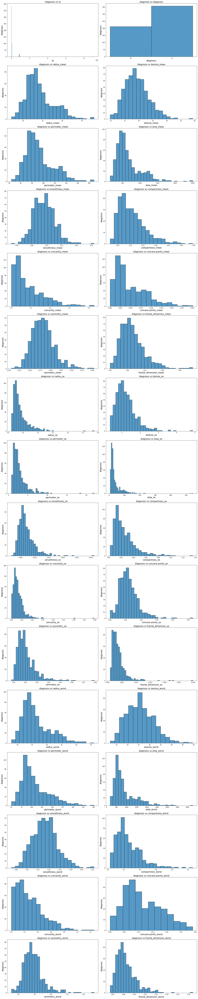

In [43]:
# single varient analysing

plt.figure(figsize=(20,100), facecolor="white")
plotnumber=1

for column in data:
    if plotnumber <= 32:
        ax=plt.subplot(16,2,plotnumber)
        sns.histplot(x=data[column])
        plt.xlabel(column, fontsize=15)
        plt.ylabel('diagnosis', fontsize=15)
        plt.title(f'diagnosis vs {column}' , fontsize=15)
    plotnumber+=1
plt.tight_layout()

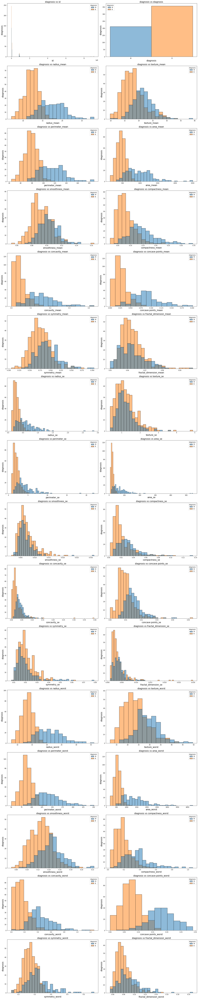

In [44]:
# single varient analysing

plt.figure(figsize=(20,100), facecolor="white")
plotnumber=1

for column in data:
    if plotnumber <= 32:
        ax=plt.subplot(16,2,plotnumber)
        sns.histplot(x=data[column], hue=data.diagnosis)
        plt.xlabel(column, fontsize=15)
        plt.ylabel('diagnosis', fontsize=15)
        plt.title(f'diagnosis vs {column}' , fontsize=15)
    plotnumber+=1
plt.tight_layout()

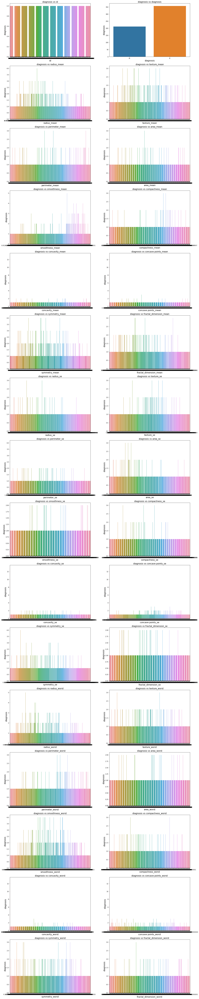

In [45]:
# single varient analysing

plt.figure(figsize=(20,100), facecolor="white")
plotnumber=1

for column in data:
    if plotnumber <= 32:
        ax=plt.subplot(16,2,plotnumber)
        sns.countplot(x=data[column])
        plt.xlabel(column, fontsize=15)
        plt.ylabel('diagnosis', fontsize=15)
        plt.title(f'diagnosis vs {column}' , fontsize=15)
    plotnumber+=1
plt.tight_layout()

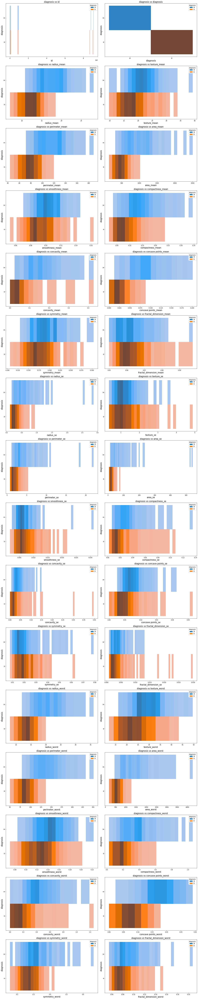

In [46]:
# single varient analysing

plt.figure(figsize=(20,100), facecolor="white")
plotnumber=1

for column in data:
    if plotnumber <= 32:
        ax=plt.subplot(16,2,plotnumber)
        sns.histplot(x=data[column], y=data.diagnosis, hue=data.diagnosis)
        plt.xlabel(column, fontsize=15)
        plt.ylabel('diagnosis', fontsize=15)
        plt.title(f'diagnosis vs {column}' , fontsize=15)
    plotnumber+=1
plt.tight_layout()

In [20]:
data.head()

,id,diagnosis,radius_mean,texture_mean,perimeter_mean,area_mean,smoothness_mean,compactness_mean,concavity_mean,concave points_mean,...,radius_worst,texture_worst,perimeter_worst,area_worst,smoothness_worst,compactness_worst,concavity_worst,concave points_worst,symmetry_worst,fractal_dimension_worst
0,842302,M,17.99,10.38,122.80,1001.0,0.11840,0.27760,0.3001,0.14710,...,25.38,17.33,184.60,2019.0,0.1622,0.6656,0.7119,0.2654,0.4601,0.11890
1,842517,M,20.57,17.77,132.90,1326.0,0.08474,0.07864,0.0869,0.07017,...,24.99,23.41,158.80,1956.0,0.1238,0.1866,0.2416,0.1860,0.2750,0.08902
2,84300903,M,19.69,21.25,130.00,1203.0,0.10960,0.15990,0.1974,0.12790,...,23.57,25.53,152.50,1709.0,0.1444,0.4245,0.4504,0.2430,0.3613,0.08758
3,84348301,M,11.42,20.38,77.58,386.1,0.14250,0.28390,0.2414,0.10520,...,14.91,26.50,98.87,567.7,0.2098,0.8663,0.6869,0.2575,0.6638,0.17300
4,84358402,M,20.29,14.34,135.10,1297.0,0.10030,0.13280,0.1980,0.10430,...,22.54,16.67,152.20,1575.0,0.1374,0.2050,0.4000,0.1625,0.2364,0.07678


C:\ProgramData\Anaconda3\lib\site-packages\seaborn\distributions.py:2551: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


<AxesSubplot:ylabel='Density'>

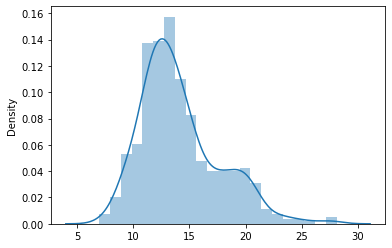

In [22]:
sns.distplot(x=data.radius_mean)

C:\ProgramData\Anaconda3\lib\site-packages\seaborn\distributions.py:2551: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
C:\ProgramData\Anaconda3\lib\site-packages\seaborn\distributions.py:2551: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
C:\ProgramData\Anaconda3\lib\site-packages\seaborn\distributions.py:2551: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-lev

C:\ProgramData\Anaconda3\lib\site-packages\seaborn\distributions.py:2551: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
C:\ProgramData\Anaconda3\lib\site-packages\seaborn\distributions.py:2551: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
C:\ProgramData\Anaconda3\lib\site-packages\seaborn\distributions.py:2551: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-lev

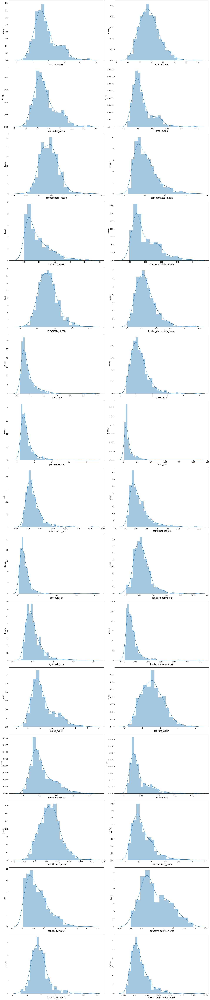

In [41]:
# single varient analysing

plt.figure(figsize=(20,100), facecolor="white")
plotnumber=1

for column in data1 :
    if plotnumber <= 32:
        ax=plt.subplot(16,2,plotnumber)
        sns.distplot(x=data1[column])
        plt.xlabel(column, fontsize=15)
    plotnumber+=1
plt.tight_layout()

In [46]:
# analysis by sweetviz

!pip install sweetviz 
import sweetviz as sv
report_1=sv.analyze(data)
report_1.show_html()


Report SWEETVIZ_REPORT.html was generated! NOTEBOOK/COLAB USERS: the web browser MAY not pop up, regardless, the report IS saved in your notebook/colab files.


<AxesSubplot:>

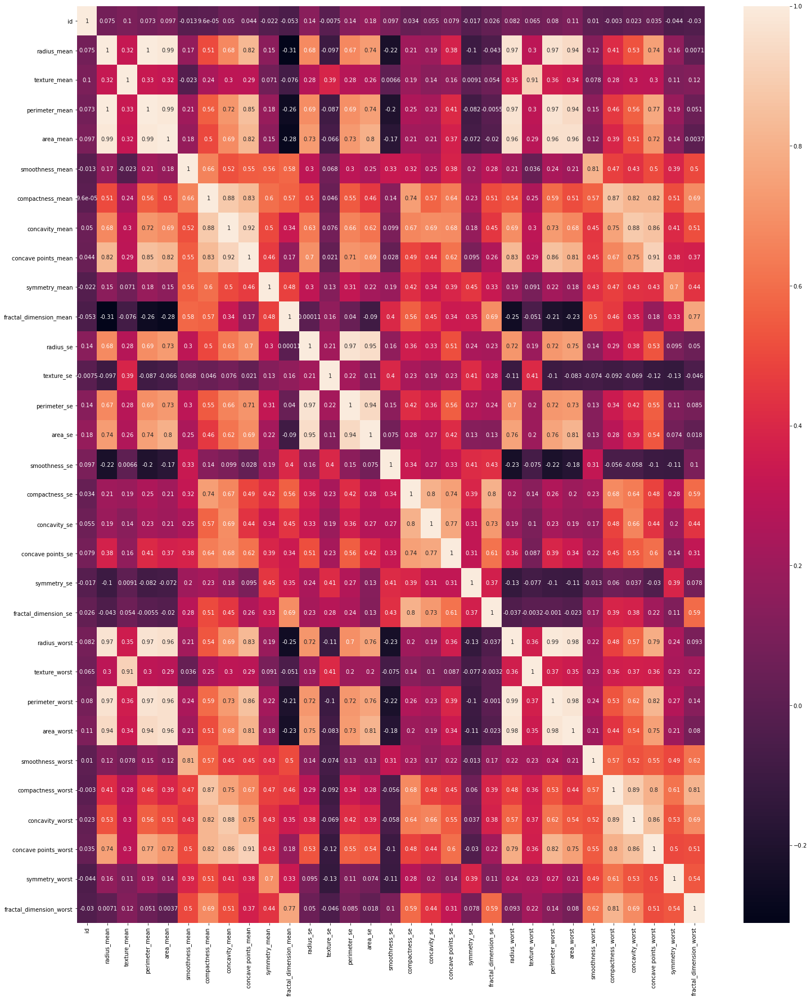

In [10]:
# heatmap relation

plt.figure(figsize=(25,30))
sns.heatmap(data.corr(), annot=True)

In [48]:
# single varients conclusion

# 1).63% of the persons from the above data have 'B' type diagnosis desease
# 2).65 % people have 'radius_mean' between 10-15
# 3).more than 30 % people have perimeter_mean of 75-85
# 4).more than 40 % people have 'average_mean' of around '500'
# 5).90 % and above people have 'smoothness_mean' between 0.08 to 0.12
# 6).number of people decreases with increasing of 'compactness_mean' value
# 7).number of people decreases with increasing of 'concavity_mean' value
# 8).number of people decreases with increasing of 'concave points_mean' value
# 9).most of the people have 'symmetry_mean' value between 0.15 - 0.20
# 10).number of people decreases with increasing of 'radius_se' value
# 11).40 % of people have 'texture_se' of 1
# 12).number of people decreases with increasing of 'perimeter_se' value
# 13).number of people decreases with increasing of 'compactness_se' value
# 14).number of people decreases with increasing of 'fractal_dimension_se' value
# 15).most of people have 'concave points_worst' between 0.05 t0 0.15

# 16). All these mentioned columns have radius_mean, perimeter_mean, texture_mean, area_mean, concavity_mean, concave_points_mean, radius_se, perimeter_se, 
      #  area_se, radius_worst, texture_worst, perimeter_worst, area_worst, concave_points_worst, 


Imported AutoViz_Class version: 0.0.81. Call using:
    from autoviz.AutoViz_Class import AutoViz_Class
    AV = AutoViz_Class()
    AV.AutoViz(filename, sep=',', depVar='', dfte=None, header=0, verbose=0,
                            lowess=False,chart_format='svg',max_rows_analyzed=150000,max_cols_analyzed=30)
Note: verbose=0 or 1 generates charts and displays them in your local Jupyter notebook.
      verbose=2 saves plots in your local machine under AutoViz_Plots directory and does not display charts.
Shape of your Data Set: (569, 33)
############## C L A S S I F Y I N G  V A R I A B L E S  ####################
Classifying variables in data set...
    Number of Numeric Columns =  30
    Number of Integer-Categorical Columns =  0
    Number of String-Categorical Columns =  0
    Number of Factor-Categorical Columns =  0
    Number of String-Boolean Columns =  1
    Number of Numeric-Boolean Columns =  0
    Number of Discrete String Columns =  0
    Number of NLP String Columns =  0


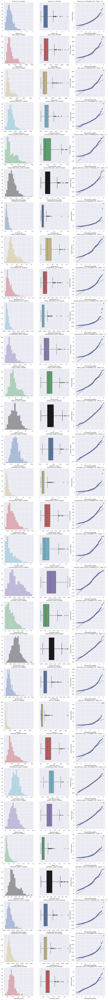

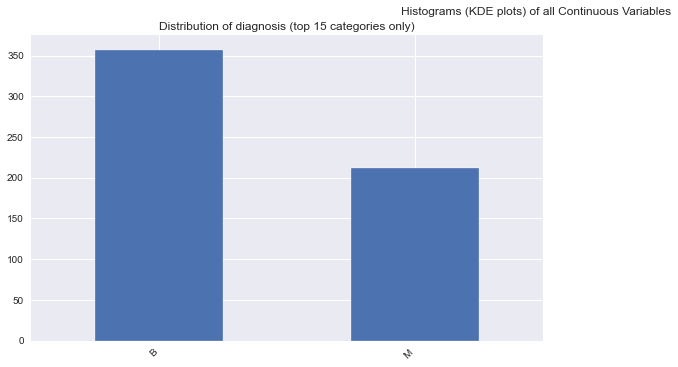

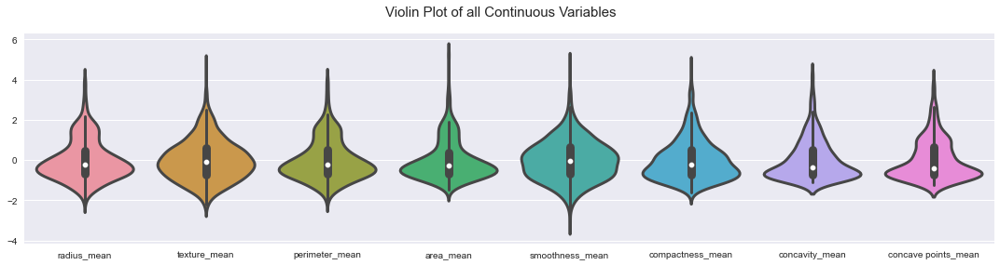

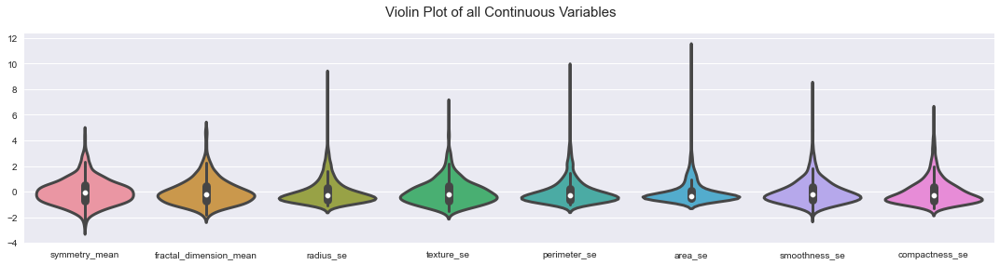

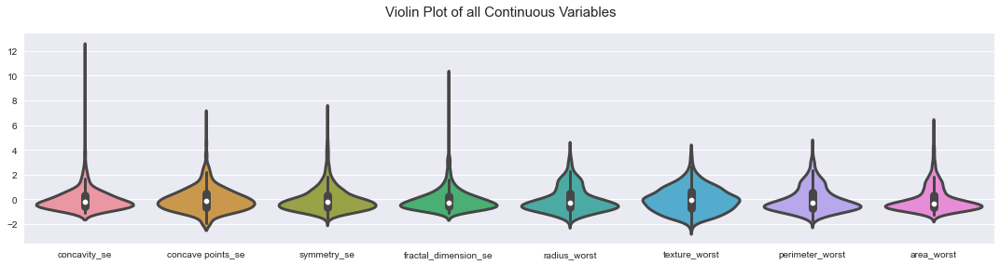

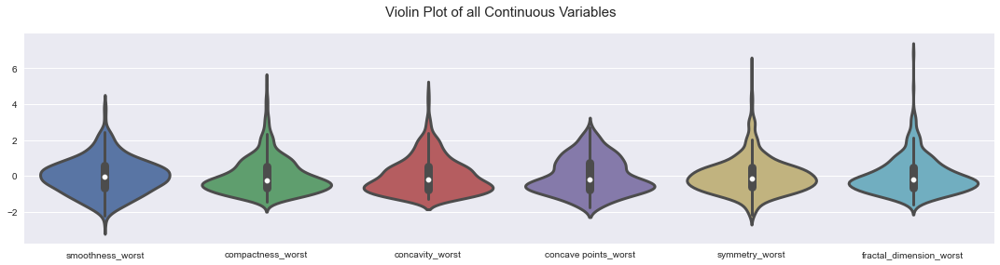

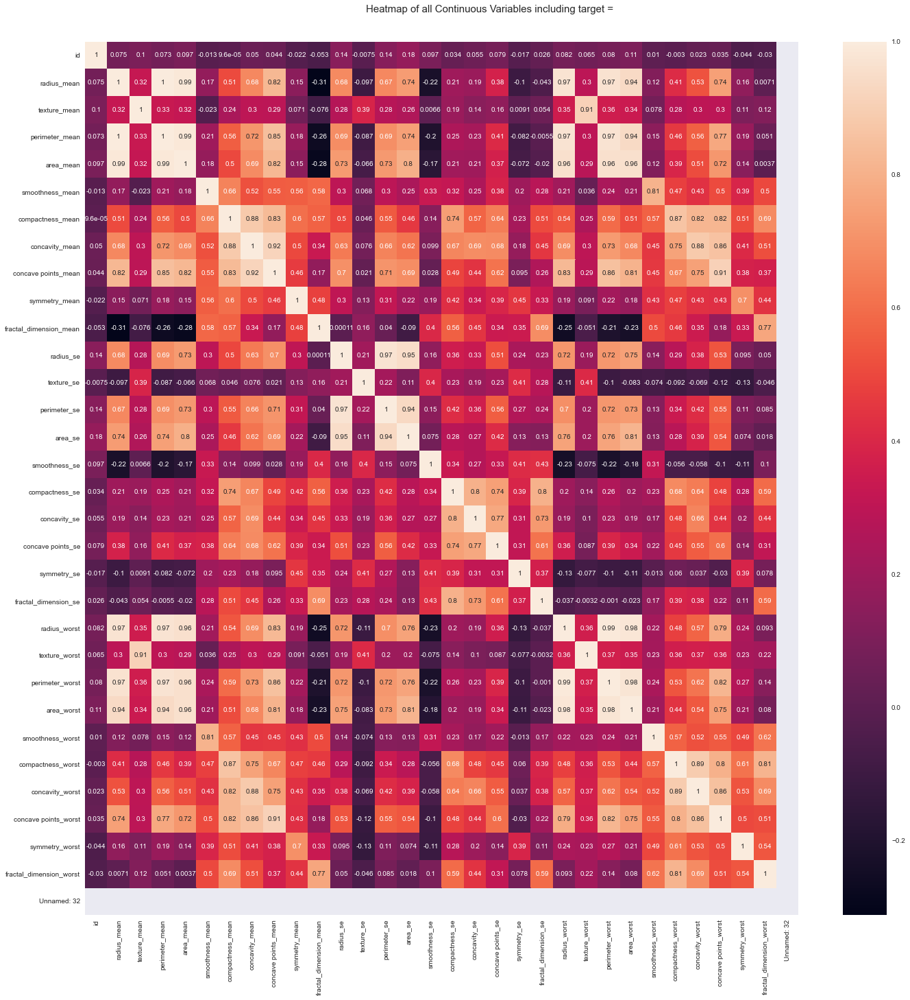

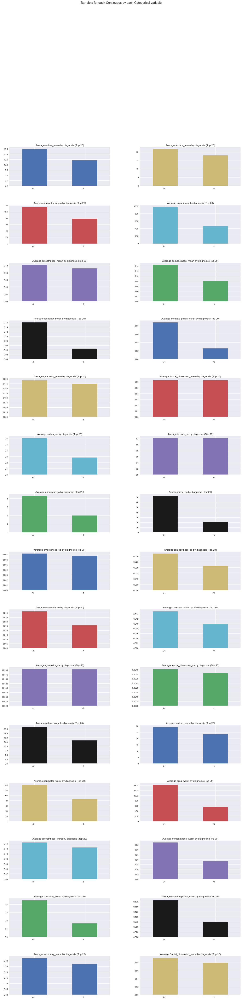

Time to run AutoViz (in seconds) = 198.870

 ###################### VISUALIZATION Completed ########################


In [14]:
# different types of data analysing all at a time

!pip install autoviz
from autoviz.AutoViz_Class import AutoViz_Class
AV= AutoViz_Class()

filename = "breast_cancer.csv"
sep = ","
dft = AV.AutoViz(
    filename,
    sep=",",
    depVar="",
    dfte=None,
    header=0,
    verbose=0,
    lowess=False,
    chart_format="svg",
    max_rows_analyzed=150000,
    max_cols_analyzed=30,
)

In [17]:
data.head()

,id,diagnosis,radius_mean,texture_mean,perimeter_mean,area_mean,smoothness_mean,compactness_mean,concavity_mean,concave_points_mean,...,radius_worst,texture_worst,perimeter_worst,area_worst,smoothness_worst,compactness_worst,concavity_worst,concave_points_worst,symmetry_worst,fractal_dimension_worst
0,842302,M,17.99,10.38,122.80,1001.0,0.11840,0.27760,0.3001,0.14710,...,25.38,17.33,184.60,2019.0,0.1622,0.6656,0.7119,0.2654,0.4601,0.11890
1,842517,M,20.57,17.77,132.90,1326.0,0.08474,0.07864,0.0869,0.07017,...,24.99,23.41,158.80,1956.0,0.1238,0.1866,0.2416,0.1860,0.2750,0.08902
2,84300903,M,19.69,21.25,130.00,1203.0,0.10960,0.15990,0.1974,0.12790,...,23.57,25.53,152.50,1709.0,0.1444,0.4245,0.4504,0.2430,0.3613,0.08758
3,84348301,M,11.42,20.38,77.58,386.1,0.14250,0.28390,0.2414,0.10520,...,14.91,26.50,98.87,567.7,0.2098,0.8663,0.6869,0.2575,0.6638,0.17300
4,84358402,M,20.29,14.34,135.10,1297.0,0.10030,0.13280,0.1980,0.10430,...,22.54,16.67,152.20,1575.0,0.1374,0.2050,0.4000,0.1625,0.2364,0.07678


In [18]:
data=data.drop(columns={'id'}, axis=1)
data.head()

,diagnosis,radius_mean,texture_mean,perimeter_mean,area_mean,smoothness_mean,compactness_mean,concavity_mean,concave_points_mean,symmetry_mean,...,radius_worst,texture_worst,perimeter_worst,area_worst,smoothness_worst,compactness_worst,concavity_worst,concave_points_worst,symmetry_worst,fractal_dimension_worst
0,M,17.99,10.38,122.80,1001.0,0.11840,0.27760,0.3001,0.14710,0.2419,...,25.38,17.33,184.60,2019.0,0.1622,0.6656,0.7119,0.2654,0.4601,0.11890
1,M,20.57,17.77,132.90,1326.0,0.08474,0.07864,0.0869,0.07017,0.1812,...,24.99,23.41,158.80,1956.0,0.1238,0.1866,0.2416,0.1860,0.2750,0.08902
2,M,19.69,21.25,130.00,1203.0,0.10960,0.15990,0.1974,0.12790,0.2069,...,23.57,25.53,152.50,1709.0,0.1444,0.4245,0.4504,0.2430,0.3613,0.08758
3,M,11.42,20.38,77.58,386.1,0.14250,0.28390,0.2414,0.10520,0.2597,...,14.91,26.50,98.87,567.7,0.2098,0.8663,0.6869,0.2575,0.6638,0.17300
4,M,20.29,14.34,135.10,1297.0,0.10030,0.13280,0.1980,0.10430,0.1809,...,22.54,16.67,152.20,1575.0,0.1374,0.2050,0.4000,0.1625,0.2364,0.07678


In [20]:
# creating dependent & independent variables

In [21]:
x= data.drop(columns={'diagnosis'}, axis=1)
y= data.diagnosis

In [22]:
# Balance the data by SMOTE

!pip install imblearn
from imblearn.over_sampling import SMOTE
smote= SMOTE()
x_smote, y_smote = smote.fit_resample(x,y)

In [24]:
# Counter

from collections import Counter
print(f"x before smote: {Counter(x)}" )
print(f"x after smote : {Counter(x_smote)}")

print(f"y before smote: {Counter(y)}")
print(f"y after smote : {Counter(y_smote)}")

x before smote: Counter({'radius_mean': 1, 'texture_mean': 1, 'perimeter_mean': 1, 'area_mean': 1, 'smoothness_mean': 1, 'compactness_mean': 1, 'concavity_mean': 1, 'concave_points_mean': 1, 'symmetry_mean': 1, 'fractal_dimension_mean': 1, 'radius_se': 1, 'texture_se': 1, 'perimeter_se': 1, 'area_se': 1, 'smoothness_se': 1, 'compactness_se': 1, 'concavity_se': 1, 'concave_points_se': 1, 'symmetry_se': 1, 'fractal_dimension_se': 1, 'radius_worst': 1, 'texture_worst': 1, 'perimeter_worst': 1, 'area_worst': 1, 'smoothness_worst': 1, 'compactness_worst': 1, 'concavity_worst': 1, 'concave_points_worst': 1, 'symmetry_worst': 1, 'fractal_dimension_worst': 1})
x after smote : Counter({'radius_mean': 1, 'texture_mean': 1, 'perimeter_mean': 1, 'area_mean': 1, 'smoothness_mean': 1, 'compactness_mean': 1, 'concavity_mean': 1, 'concave_points_mean': 1, 'symmetry_mean': 1, 'fractal_dimension_mean': 1, 'radius_se': 1, 'texture_se': 1, 'perimeter_se': 1, 'area_se': 1, 'smoothness_se': 1, 'compactness_

In [25]:
Counter(y_smote)

Counter({'M': 357, 'B': 357})

In [26]:
y_smote.value_counts()

B    357
M    357
Name: diagnosis, dtype: int64

In [27]:
# scaling the data is done when magnitude of data varies a lot

from sklearn.preprocessing import StandardScaler
sc= StandardScaler()
x_scaled= sc.fit_transform(x)
x_scaled


array([[ 1.09706398, -2.07333501,  1.26993369, ...,  2.29607613,
         2.75062224,  1.93701461],
       [ 1.82982061, -0.35363241,  1.68595471, ...,  1.0870843 ,
        -0.24388967,  0.28118999],
       [ 1.57988811,  0.45618695,  1.56650313, ...,  1.95500035,
         1.152255  ,  0.20139121],
       ...,
       [ 0.70228425,  2.0455738 ,  0.67267578, ...,  0.41406869,
        -1.10454895, -0.31840916],
       [ 1.83834103,  2.33645719,  1.98252415, ...,  2.28998549,
         1.91908301,  2.21963528],
       [-1.80840125,  1.22179204, -1.81438851, ..., -1.74506282,
        -0.04813821, -0.75120669]])

In [28]:
x_scaled_df = pd.DataFrame(x_scaled, columns=x.columns)
x_scaled_df

,radius_mean,texture_mean,perimeter_mean,area_mean,smoothness_mean,compactness_mean,concavity_mean,concave_points_mean,symmetry_mean,fractal_dimension_mean,...,radius_worst,texture_worst,perimeter_worst,area_worst,smoothness_worst,compactness_worst,concavity_worst,concave_points_worst,symmetry_worst,fractal_dimension_worst
0,1.097064,-2.073335,1.269934,0.984375,1.568466,3.283515,2.652874,2.532475,2.217515,2.255747,...,1.886690,-1.359293,2.303601,2.001237,1.307686,2.616665,2.109526,2.296076,2.750622,1.937015
1,1.829821,-0.353632,1.685955,1.908708,-0.826962,-0.487072,-0.023846,0.548144,0.001392,-0.868652,...,1.805927,-0.369203,1.535126,1.890489,-0.375612,-0.430444,-0.146749,1.087084,-0.243890,0.281190
2,1.579888,0.456187,1.566503,1.558884,0.942210,1.052926,1.363478,2.037231,0.939685,-0.398008,...,1.511870,-0.023974,1.347475,1.456285,0.527407,1.082932,0.854974,1.955000,1.152255,0.201391
3,-0.768909,0.253732,-0.592687,-0.764464,3.283553,3.402909,1.915897,1.451707,2.867383,4.910919,...,-0.281464,0.133984,-0.249939,-0.550021,3.394275,3.893397,1.989588,2.175786,6.046041,4.935010
4,1.750297,-1.151816,1.776573,1.826229,0.280372,0.539340,1.371011,1.428493,-0.009560,-0.562450,...,1.298575,-1.466770,1.338539,1.220724,0.220556,-0.313395,0.613179,0.729259,-0.868353,-0.397100
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
564,2.110995,0.721473,2.060786,2.343856,1.041842,0.219060,1.947285,2.320965,-0.312589,-0.931027,...,1.901185,0.117700,1.752563,2.015301,0.378365,-0.273318,0.664512,1.629151,-1.360158,-0.709091
565,1.704854,2.085134,1.615931,1.723842,0.102458,-0.017833,0.693043,1.263669,-0.217664,-1.058611,...,1.536720,2.047399,1.421940,1.494959,-0.691230,-0.394820,0.236573,0.733827,-0.531855,-0.973978
566,0.702284,2.045574,0.672676,0.577953,-0.840484,-0.038680,0.046588,0.105777,-0.809117,-0.895587,...,0.561361,1.374854,0.579001,0.427906,-0.809587,0.350735,0.326767,0.414069,-1.104549,-0.318409
567,1.838341,2.336457,1.982524,1.735218,1.525767,3.272144,3.296944,2.658866,2.137194,1.043695,...,1.961239,2.237926,2.303601,1.653171,1.430427,3.904848,3.197605,2.289985,1.919083,2.219635


In [29]:
# testing and training data

from sklearn.model_selection import train_test_split
x_train, x_test, y_train, y_test = train_test_split(x_scaled_df, y, test_size=.3, random_state=20)


In [30]:
x_train

,radius_mean,texture_mean,perimeter_mean,area_mean,smoothness_mean,compactness_mean,concavity_mean,concave_points_mean,symmetry_mean,fractal_dimension_mean,...,radius_worst,texture_worst,perimeter_worst,area_worst,smoothness_worst,compactness_worst,concavity_worst,concave_points_worst,symmetry_worst,fractal_dimension_worst
435,-0.041833,0.076875,-0.034972,-0.157532,0.686015,0.169787,0.298817,0.405245,-0.520693,0.374586,...,0.159621,0.834212,0.197742,-0.019835,1.268234,0.652266,0.646282,1.036837,0.450138,1.194443
72,0.872693,1.217138,0.915698,0.780737,0.764297,1.490705,1.009428,0.787254,0.421251,0.293783,...,1.460100,1.326001,1.320668,1.407063,1.145493,3.086136,1.844223,1.146468,0.666921,2.768252
266,-1.001801,-0.079038,-0.934566,-0.877375,0.036986,0.196319,-0.312987,-0.580343,0.402996,0.299453,...,-0.908925,-0.445740,-0.863230,-0.801227,-0.485202,-0.017590,-0.386625,-0.538203,0.063489,-0.447528
468,0.986298,0.940217,1.113411,0.926071,-0.246964,1.820460,1.566869,1.322737,-0.422117,1.544110,...,1.097705,0.519924,1.082381,0.978132,-0.511503,1.426448,1.172090,1.294166,-0.970273,2.130970
456,-0.709266,2.327149,-0.704313,-0.681985,-0.198572,-0.352516,-0.215937,-0.741555,-0.046070,-0.161268,...,-0.652142,2.138591,-0.632092,-0.620162,0.360831,-0.325481,0.096485,-0.704325,-0.027107,-0.650904
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
218,1.611130,0.528326,1.554146,1.635674,-0.180069,0.497647,0.482119,0.979935,1.030958,-0.990566,...,1.959169,0.482470,1.877663,1.983658,0.128501,0.440431,0.429434,1.026178,0.273800,-0.077350
223,0.460872,0.223480,0.437892,0.302644,0.436936,0.304342,0.325182,0.404988,0.450458,0.032944,...,0.681469,0.751162,0.555172,0.364621,1.000835,1.232425,0.601665,0.506951,1.767012,1.244317
271,-0.805831,-1.454335,-0.813055,-0.759060,0.140888,-0.535587,-0.704953,-0.551195,-0.155598,-0.013837,...,-0.817808,-1.546564,-0.863528,-0.743743,0.150419,-0.658818,-0.694146,-0.412736,-0.271392,-0.206469
474,-0.922277,-0.853952,-0.888021,-0.841823,0.308838,0.048497,-0.472686,-0.856596,0.180289,0.789944,...,-0.896500,-1.030349,-0.788765,-0.786636,0.036445,0.862192,0.308536,-0.532112,-0.517295,1.332982


In [31]:
y_train

435    M
72     M
266    B
468    M
456    B
      ..
218    M
223    M
271    B
474    B
355    B
Name: diagnosis, Length: 398, dtype: object

In [32]:
# model creation

from sklearn.neural_network import MLPClassifier
model = MLPClassifier(hidden_layer_sizes=(50,3),
                       learning_rate_init=0.1,
                       max_iter=100,
                       random_state=2)  # modelccreation

model.fit(x_train, y_train)  # training data

MLPClassifier(hidden_layer_sizes=(50, 3), learning_rate_init=0.1, max_iter=100,
              random_state=2)

In [33]:
y_test_proba= model.predict_proba(x_test)  # predicting y proba
y_test_proba


array([[1.00000000e+00, 2.46423247e-16],
       [6.22497037e-05, 9.99937750e-01],
       [0.00000000e+00, 1.00000000e+00],
       [9.99999971e-01, 2.92374135e-08],
       [0.00000000e+00, 1.00000000e+00],
       [0.00000000e+00, 1.00000000e+00],
       [0.00000000e+00, 1.00000000e+00],
       [9.99845807e-01, 1.54193144e-04],
       [1.00000000e+00, 2.81182797e-28],
       [0.00000000e+00, 1.00000000e+00],
       [0.00000000e+00, 1.00000000e+00],
       [1.00000000e+00, 5.90106864e-11],
       [9.99999999e-01, 1.21287633e-09],
       [0.00000000e+00, 1.00000000e+00],
       [9.78110582e-01, 2.18894184e-02],
       [9.99999965e-01, 3.45910869e-08],
       [1.00000000e+00, 3.79803846e-12],
       [1.74123681e-02, 9.82587632e-01],
       [0.00000000e+00, 1.00000000e+00],
       [1.00000000e+00, 1.60923318e-23],
       [9.99999686e-01, 3.13528996e-07],
       [1.00000000e+00, 4.99728305e-14],
       [7.32747196e-15, 1.00000000e+00],
       [3.78212794e-09, 9.99999996e-01],
       [0.000000

In [34]:
y_test_pred = model.predict(x_test)
y_test_pred

array(['B', 'M', 'M', 'B', 'M', 'M', 'M', 'B', 'B', 'M', 'M', 'B', 'B',
       'M', 'B', 'B', 'B', 'M', 'M', 'B', 'B', 'B', 'M', 'M', 'M', 'M',
       'M', 'B', 'B', 'B', 'M', 'B', 'M', 'B', 'M', 'M', 'M', 'B', 'M',
       'B', 'M', 'B', 'B', 'B', 'M', 'B', 'B', 'B', 'B', 'M', 'B', 'B',
       'M', 'B', 'B', 'B', 'B', 'B', 'B', 'B', 'B', 'B', 'B', 'B', 'M',
       'B', 'M', 'B', 'B', 'M', 'M', 'M', 'M', 'B', 'B', 'M', 'M', 'M',
       'M', 'B', 'B', 'M', 'B', 'B', 'B', 'M', 'B', 'B', 'B', 'B', 'B',
       'M', 'B', 'B', 'M', 'M', 'M', 'B', 'B', 'M', 'B', 'M', 'M', 'M',
       'B', 'B', 'M', 'M', 'B', 'M', 'B', 'B', 'M', 'B', 'B', 'M', 'B',
       'B', 'M', 'M', 'B', 'B', 'M', 'B', 'M', 'B', 'B', 'B', 'B', 'B',
       'M', 'M', 'B', 'B', 'B', 'M', 'B', 'M', 'B', 'B', 'M', 'B', 'B',
       'M', 'B', 'B', 'M', 'B', 'B', 'B', 'B', 'B', 'M', 'B', 'B', 'M',
       'M', 'B', 'B', 'M', 'B', 'B', 'B', 'B', 'B', 'B', 'M', 'B', 'M',
       'B', 'M'], dtype='<U1')

In [35]:
y_train_pred= model.predict(x_train)  # predicting y
y_train_pred

array(['M', 'M', 'B', 'M', 'B', 'M', 'B', 'B', 'B', 'B', 'B', 'B', 'M',
       'M', 'B', 'B', 'M', 'M', 'B', 'M', 'M', 'B', 'B', 'B', 'B', 'B',
       'B', 'B', 'B', 'B', 'B', 'M', 'B', 'B', 'B', 'B', 'B', 'B', 'B',
       'B', 'M', 'B', 'B', 'M', 'M', 'B', 'B', 'B', 'M', 'B', 'M', 'B',
       'B', 'B', 'B', 'B', 'B', 'M', 'B', 'B', 'B', 'M', 'M', 'M', 'B',
       'B', 'M', 'M', 'B', 'B', 'M', 'M', 'B', 'B', 'M', 'B', 'B', 'M',
       'B', 'B', 'M', 'B', 'B', 'B', 'M', 'M', 'B', 'B', 'M', 'B', 'B',
       'M', 'B', 'M', 'M', 'M', 'M', 'B', 'M', 'B', 'B', 'B', 'M', 'B',
       'B', 'B', 'M', 'B', 'M', 'M', 'M', 'B', 'B', 'M', 'B', 'B', 'B',
       'B', 'M', 'B', 'M', 'B', 'B', 'B', 'B', 'M', 'M', 'B', 'B', 'B',
       'B', 'B', 'B', 'M', 'B', 'B', 'B', 'B', 'B', 'M', 'B', 'B', 'M',
       'B', 'B', 'B', 'M', 'M', 'B', 'M', 'B', 'M', 'M', 'B', 'B', 'B',
       'M', 'B', 'B', 'B', 'B', 'B', 'B', 'M', 'B', 'B', 'B', 'M', 'M',
       'B', 'B', 'B', 'M', 'B', 'B', 'M', 'B', 'B', 'B', 'M', 'M

In [41]:
# accuracy_score, classification_report

from sklearn.metrics import accuracy_score, classification_report

accuracy_y_test= accuracy_score(y_test, y_test_pred ) 
print(f"y_test_accuracy : " , accuracy_y_test*100)

accuracy_y_train= accuracy_score(y_train,y_train_pred)
print(f"y_train_accuracy : ", accuracy_y_train*100)

y_test_accuracy :  97.6608187134503
y_train_accuracy :  100.0


In [39]:
# confusion matrix
pd.crosstab(y_test, y_test_pred)

col_0,B,M
diagnosis,,
B,103,4
M,0,64


In [40]:
# classification_report
full_report= classification_report(y_test, y_test_pred)
print(full_report)

              precision    recall  f1-score   support

           B       1.00      0.96      0.98       107
           M       0.94      1.00      0.97        64

    accuracy                           0.98       171
   macro avg       0.97      0.98      0.98       171
weighted avg       0.98      0.98      0.98       171

